In [15]:
import os
import glob
import json
import pandas as pd
import numpy as np
import warnings

# Suppress FutureWarning
warnings.filterwarnings("ignore", category=FutureWarning)

data_dir = "../data"

json_files = glob.glob(os.path.join(data_dir, "*.json"))

all_data = []

for file in json_files:
    with open(file, 'r', encoding='utf-8') as f:
        data = json.load(f)
        symbol = os.path.splitext(os.path.basename(file))[0].split("_")[0]
        for record in data.get('data', []):
            record['symbol'] = symbol
            all_data.append(record)

combined_df = pd.DataFrame(all_data)
print(combined_df.head())

       timestamp      open      high       low     close     volume  \
0  1740658500000  86380.01  86491.25  86264.15  86483.43  221.10781   
1  1740659400000  86483.43  86687.02  86358.66  86687.02  276.62585   
2  1740660300000  86687.02  86687.02  86270.94  86330.59  212.39311   
3  1740661200000  86330.59  86440.00  86240.18  86440.00  260.81538   
4  1740662100000  86440.00  86527.99  86255.49  86471.85  236.19353   

      close_time  quote_volume  trades  taker_buy_volume  ...         obv  \
0  1740659399999  1.909143e+07   33334          92.10947  ...  3720.88507   
1  1740660299999  2.393584e+07   42699         129.28068  ...  3997.51092   
2  1740661199999  1.836765e+07   46751          66.54017  ...  3785.11781   
3  1740662099999  2.252109e+07   32192         144.60905  ...  4045.93319   
4  1740662999999  2.040773e+07   39338         122.62591  ...  4282.12672   

   best_bid_price  best_ask_price  best_bid_volume  best_ask_volume  \
0        86397.05        86397.06      

In [16]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

df_normalized = combined_df.copy()

ohlc_columns = ['open', 'high', 'low', 'close']

volume_columns = ['volume', 'quote_volume', 'trades', 'taker_buy_volume', 'taker_buy_quote_volume']

order_book_columns = [
    'best_bid_volume', 'best_ask_volume', 'bid_volume_depth', 'ask_volume_depth',
    'best_bid_price', 'best_ask_price', 'bid_ask_spread', 'order_book_imbalance'
]

indicator_columns = [
    'sma_10', 'sma_50', 'ema_10', 'ema_50',
    'bollinger_upper', 'bollinger_middle', 'bollinger_lower',
    'macd', 'macd_signal', 'atr', 'obv', 'rsi_14'
]

# Iterate through unique symbols in the DataFrame
for symbol in df_normalized['symbol'].unique():
    # Filter data for the current symbol
    symbol_data = df_normalized[df_normalized['symbol'] == symbol]

    # Create a new MinMaxScaler and StandardScaler instance
    minmax_scaler = MinMaxScaler()
    standard_scaler = StandardScaler()

    # Apply MinMaxScaler on OHLC columns for the current symbol
    df_normalized.loc[symbol_data.index, ohlc_columns] = minmax_scaler.fit_transform(symbol_data[ohlc_columns])

    # Apply log transformation to volume columns for the current symbol
    df_normalized.loc[symbol_data.index, volume_columns] = minmax_scaler.fit_transform(symbol_data[volume_columns])

    # Apply StandardScaler to order book columns for the current symbol
    # TODO: migh be problematic!!!
    df_normalized.loc[symbol_data.index, order_book_columns] = minmax_scaler.fit_transform(symbol_data[order_book_columns])

    # Apply MinMaxScaler to indicator columns for the current symbol
    df_normalized.loc[symbol_data.index, indicator_columns] = minmax_scaler.fit_transform(symbol_data[indicator_columns])

# Keep only OHLC columns, timestamp, and symbol for export
# df_normalized = df_normalized[['timestamp'] + ohlc_columns + ['symbol']]

# Save the normalized DataFrame to a CSV file in the data directory
output_path = os.path.join(data_dir, 'df_normalized.csv')
df_normalized.to_csv(output_path, index=False)

print(f'Normalized DataFrame saved to {output_path}')

Normalized DataFrame saved to ../data/df_normalized.csv


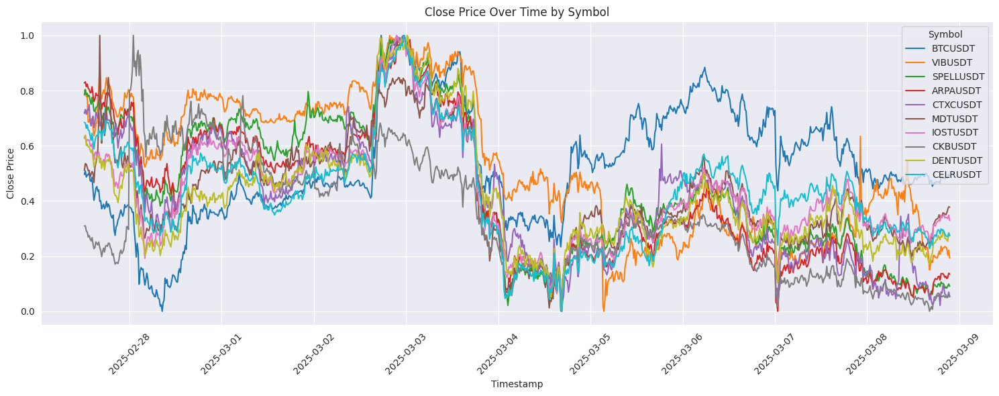

In [17]:
import matplotlib.pyplot as plt

# Convert 'timestamp' column to datetime for better visualization
df_normalized['timestamp'] = pd.to_datetime(df_normalized['timestamp'], unit='ms')

# Define figure size for a longer plot
plt.figure(figsize=(15, 6))

# Plot each symbol's close price over time
for symbol in df_normalized['symbol'].unique():
    symbol_data = df_normalized[df_normalized['symbol'] == symbol]
    plt.plot(symbol_data['timestamp'], symbol_data['close'], label=symbol)

plt.title('Close Price Over Time by Symbol')
plt.xlabel('Timestamp')
plt.ylabel('Close Price')
plt.legend(title='Symbol')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

symbol     ARPAUSDT   BTCUSDT  CELRUSDT   CKBUSDT  CTXCUSDT  DENTUSDT  \
symbol                                                                  
ARPAUSDT   1.000000  0.247482  0.720330  0.461128  0.552152  0.735545   
BTCUSDT    0.247482  1.000000  0.366095  0.199911  0.266652  0.380103   
CELRUSDT   0.720330  0.366095  1.000000  0.394047  0.589144  0.838574   
CKBUSDT    0.461128  0.199911  0.394047  1.000000  0.373873  0.422490   
CTXCUSDT   0.552152  0.266652  0.589144  0.373873  1.000000  0.556037   
DENTUSDT   0.735545  0.380103  0.838574  0.422490  0.556037  1.000000   
IOSTUSDT   0.743922  0.423127  0.891887  0.458159  0.596434  0.906128   
MDTUSDT    0.636006  0.294282  0.816317  0.332287  0.538749  0.711099   
SPELLUSDT  0.764067  0.310668  0.792125  0.502299  0.560175  0.776792   
VIBUSDT    0.203006  0.185390  0.281926  0.201500  0.223086  0.260950   

symbol     IOSTUSDT   MDTUSDT  SPELLUSDT   VIBUSDT  
symbol                                              
ARPAUSDT   0.7439

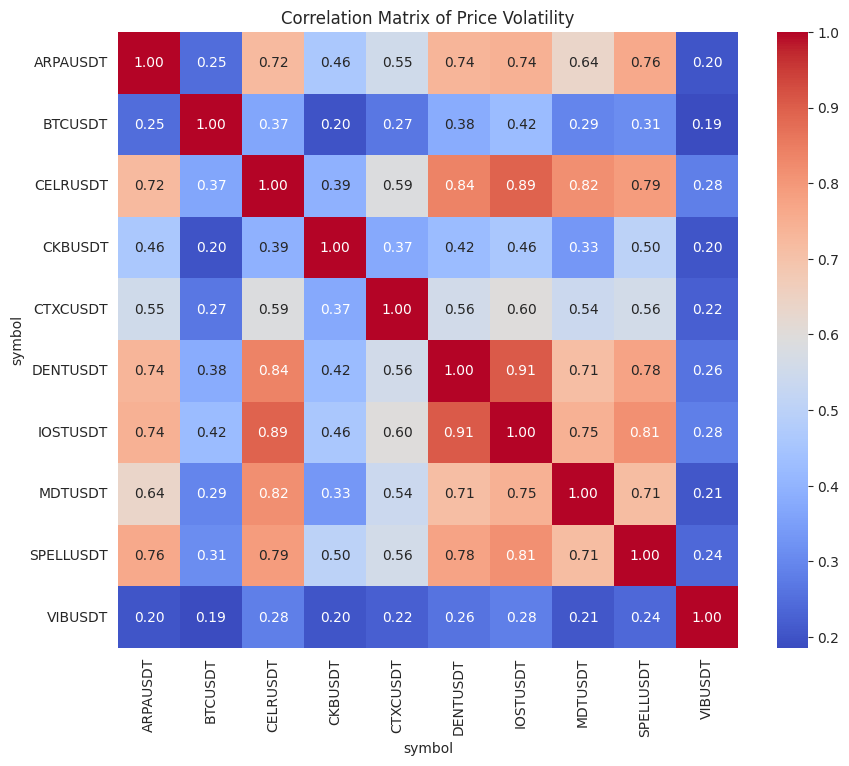

In [18]:
volatility_df = df_normalized.copy()

# Calculate percentage change to measure price volatility
volatility_df['price_change'] = volatility_df.groupby('symbol')['close'].pct_change()

# Create a pivot table where rows are timestamps and columns are symbols
volatility_pivot = volatility_df.pivot(index='timestamp', columns='symbol', values='price_change')

# Compute the correlation matrix
correlation_matrix = volatility_pivot.corr()

print(correlation_matrix)

# Visualize the correlation matrix as a heatmap
import seaborn as sns
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", cbar=True)
plt.title('Correlation Matrix of Price Volatility')
plt.show()

In [21]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
import pandas as pd

# Exclude 'timestamp' and 'close_time' from the feature selection process
numeric_df = df_normalized.drop(columns=['high', 'timestamp', 'close_time']).select_dtypes(include=['number'])

model = LinearRegression()

rfe = RFE(
    estimator=model,
    n_features_to_select=10
)

rfe.fit(numeric_df, df_normalized['high'])

feature_ranking = pd.DataFrame({
    'feature': numeric_df.columns,
    'selected': rfe.support_,
    'ranking': rfe.ranking_
})

# Keep the selected features and also explicitly include 'timestamp', 'close_time', and 'symbol'
df_linear_regression_features = numeric_df.loc[:, rfe.support_]
df_linear_regression_features = df_normalized[['timestamp', 'close_time', 'symbol']].join(
    numeric_df.loc[:, rfe.support_]
)

print("Columns selected for linear regression:\n")
print(feature_ranking[feature_ranking['selected']])

print('\n')
print(df_linear_regression_features.head())

Columns selected for linear regression:

             feature  selected  ranking
0               open      True        1
1                low      True        1
2              close      True        1
3             volume      True        1
4       quote_volume      True        1
6   taker_buy_volume      True        1
10            ema_10      True        1
13   bollinger_upper      True        1
14  bollinger_middle      True        1
15   bollinger_lower      True        1


            timestamp     close_time   symbol      open       low     close  \
0 2025-02-27 12:15:00  1740659399999  BTCUSDT  0.489853  0.501167  0.496272   
1 2025-02-27 12:30:00  1740660299999  BTCUSDT  0.496272  0.507083  0.508907   
2 2025-02-27 12:45:00  1740661199999  BTCUSDT  0.508907  0.501592  0.486786   
3 2025-02-27 13:00:00  1740662099999  BTCUSDT  0.486786  0.499666  0.493576   
4 2025-02-27 13:15:00  1740662999999  BTCUSDT  0.493576  0.500625  0.495553   

     volume  quote_volume  taker_buy_volum

In [22]:
import plotly.express as px
from sklearn.decomposition import PCA
import pandas as pd

# Perform PCA transformation
pca = PCA(n_components=3)
pca_result = pca.fit_transform(df_linear_regression_features.drop(columns=['timestamp', 'close_time', 'symbol']))

# Create a DataFrame with PCA components
pca_df = pd.DataFrame(pca_result, columns=['Főtengely 1', 'Főtengely 2', 'Főtengely 3'])

# Add the symbol column for coloring
pca_df['symbol'] = df_linear_regression_features['symbol'].values

# Define order for symbols (optional: customize as needed)
category_orders = {'symbol': sorted(pca_df['symbol'].unique())}

# Create interactive 3D scatter plot
fig = px.scatter_3d(
    pca_df,
    x='Főtengely 1',
    y='Főtengely 2',
    z='Főtengely 3',
    color='symbol',  # Use symbol column for color
    hover_data=['symbol'],  # Add symbol to hover information
    category_orders=category_orders,  # Control the color legend order
    title='Interaktív 3D PCA ábra',
    labels={'Főtengely 1': 'Főkomponens 1', 'Főtengely 2': 'Főkomponens 2', 'Főtengely 3': 'Főkomponens 3'},
    opacity=0.7
)

# Modify trace and layout as requested
fig.update_traces(marker=dict(size=3), visible=True)
fig.update_layout(
    showlegend=True,  # Ensure legend is displayed
    title='PCA Visualization by Symbol',
    plot_bgcolor='white',  # Correct black plot background to white
    paper_bgcolor='white',  # Ensure paper background is white
    scene=dict(
        xaxis=dict(title='Főkomponens 1', backgroundcolor='white', color='black', gridcolor='lightgrey'),
        yaxis=dict(title='Főkomponens 2', backgroundcolor='white', color='black', gridcolor='lightgrey'),
        zaxis=dict(title='Főkomponens 3', backgroundcolor='white', color='black', gridcolor='lightgrey')
    )
)

# Show the plot
fig.show()

In [25]:
import plotly.express as px

# Add 'timestamp' and keep 'symbol' in the PCA DataFrame
pca_df['timestamp'] = df_linear_regression_features['timestamp']

# Convert 'timestamp' to datetime for better visualization
pca_df['timestamp'] = pd.to_datetime(pca_df['timestamp'], unit='ms')

# Iterate over PCA components and create separate line charts
pca_axis_mapping = {
    'Főtengely 1': 'Primarily combines open, close, and SMA values',
    'Főtengely 2': 'Primarily combines volume and quote volume',
    'Főtengely 3': 'Primarily influenced by Bollinger Bands and EMA'
}

for component in ['Főtengely 1', 'Főtengely 2', 'Főtengely 3']:
    fig = px.line(
        pca_df,
        x='timestamp',
        y=component,  # Select the individual PCA component
        color='symbol',  # Use symbol for color differentiation
        title=f"Time Series Analysis of {component}",  # Chart title
        labels={
            'timestamp': 'Timestamp',
            component: 'Principal Component Value',
            'symbol': 'Symbol'
        },
        template='plotly_white'  # Use a clean white background
    )

    dimension_description = pca_axis_mapping.get(component, '')
    fig.add_annotation(
        text=f"Axis Composition: {dimension_description}",
        xref="paper", yref="paper",
        x=0.5, y=-0.15, showarrow=False,  # Position below the plot
        font=dict(size=10, color="gray")
    )

    # Update layout for better readability
    fig.update_layout(
        xaxis_title='Timestamp',
        yaxis_title='Principal Component Value',
        legend_title='Symbol',
        legend=dict(
            title_font=dict(size=12),
            font=dict(size=10),
            orientation="h",  # Horizontal legend
            yanchor="bottom", y=1.02, xanchor="right", x=1  # Place legend at the top
        )
    )

    # Display the plot for the current component
    fig.show()

In [24]:
from sklearn.cluster import AgglomerativeClustering
import plotly.express as px

# Perform Agglomerative Clustering with 6 clusters
agg_cluster = AgglomerativeClustering(n_clusters=6, linkage='ward')
pca_df['agg_cluster'] = agg_cluster.fit_predict(pca_df[['Főtengely 1', 'Főtengely 2', 'Főtengely 3']])

# Visualize clusters in 3D
fig_3d = px.scatter_3d(
    pca_df,
    x='Főtengely 1',
    y='Főtengely 2',
    z='Főtengely 3',
    color='agg_cluster',
    color_discrete_sequence=px.colors.qualitative.Set2,
    labels={'agg_cluster': 'Cluster'},
    title="Agglomerative Clusters Visualized in 3D",
    template="plotly_white",
    opacity=0.8
)
fig_3d.update_traces(marker=dict(size=5))
fig_3d.update_layout(
    legend=dict(
        title="Clusters",
        x=0.99, xanchor="right",
        y=0.99, yanchor="top",
        bgcolor="rgba(255, 255, 255, 0.6)"
    )
)
fig_3d.show()

# Visualize clusters over time for each principal component
for component in ['Főtengely 1', 'Főtengely 2', 'Főtengely 3']:
    fig_time_series = px.scatter(
        pca_df,
        x='timestamp',
        y=component,
        color='agg_cluster',
        symbol='symbol',  # Use "symbol" to represent each symbol
        color_discrete_sequence=px.colors.qualitative.Set2,
        labels={'agg_cluster': 'Cluster', 'symbol': 'Symbol'},
        title=f"Agglomerative Clusters over Time ({component})",
        template="plotly_white",
        opacity=0.8
    )
    fig_time_series.update_traces(marker=dict(size=5))
    fig_time_series.update_layout(
        legend=dict(
            title="Clusters",
            x=0.99, xanchor="right",
            y=0.99, yanchor="top",
            bgcolor="rgba(255, 255, 255, 0.6)"
        )
    )
    fig_time_series.show()